# **Εργασία** **1** **-** **Τεχνικές** **Εξόρυξης** **Δεδομένων**
Ονοματεπώνυμα: Αναστασία Ορφανουδάκη & Αλέξανδρος Κούτρας

Α.Μ: 1115202100129 & 1115202100073

# **ΜΕΡΟΣ 1ο**

Φορτώνουμε τα αρχεία για κάθε μήνα του 2019, τα ενώνουμε σε ένα dataframe και επεξεργαζόμαστε τα missing data και τις ακραίες τιμές.




In [1]:
import pandas as pd

In [2]:
import matplotlib.pyplot as plt

In [3]:
import numpy as np

In [4]:
import folium

In [5]:
from collections import Counter

In [6]:
import re

In [7]:
from wordcloud import STOPWORDS

In [8]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [9]:
from nltk.corpus import stopwords

In [10]:
from nltk.collocations import BigramCollocationFinder

In [11]:
from nltk.metrics import BigramAssocMeasures

In [12]:
from nltk.tokenize import word_tokenize

In [13]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [14]:
from sklearn.metrics.pairwise import cosine_similarity

In [15]:
from geopy.distance import geodesic as GD

In [16]:
from wordcloud import WordCloud

In [17]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [18]:
# Αποθηκεύουμε σε μία μεταβλητή τις στήλες που θέλουμε να κρατήσουμε για το  train_2019.csv αρχείο
desire_columns = ['id', 'zipcode', 'transit', 'bedrooms', 'beds', 'review_scores_rating', 'number_of_reviews', 'neighbourhood', 'name', 'latitude', 'longitude', 'last_review', 'instant_bookable', 'host_since', 'host_response_rate','host_identity_verified', 'host_has_profile_pic', 'first_review', 'description', 'city', 'cancellation_policy', 'bed_type', 'bathrooms', 'accommodates', 'amenities', 'room_type', 'property_type', 'price', 'availability_365', 'minimum_nights']

In [19]:
# Διαβάζομυε τα listing.csv αρχεία για όλους τους μήνες
listingFeb19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/febrouary/listings.csv')
listingMarch19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/march/listings.csv')
listingApril19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/april/listings.csv')

<ipython-input-19-a23610184c5c>:2: DtypeWarning: Columns (61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  listingFeb19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/febrouary/listings.csv')
<ipython-input-19-a23610184c5c>:3: DtypeWarning: Columns (61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  listingMarch19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/march/listings.csv')
<ipython-input-19-a23610184c5c>:4: DtypeWarning: Columns (61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  listingApril19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/april/listings.csv')


In [20]:
# Κρατάμε τις στήλες που θα χρειαστούμε
listingFeb19 = listingFeb19[desire_columns]
listingMarch19 = listingMarch19[desire_columns]
listingApril19 = listingApril19[desire_columns]

# Kαι προσθέτουμε σε μία καινούρια στήλη τον μήνα
listingFeb19['month']='02'
listingMarch19['month']='03'
listingApril19['month'] = '04'

<ipython-input-20-a9ab991ee5d9>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listingFeb19['month']='02'
<ipython-input-20-a9ab991ee5d9>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listingMarch19['month']='03'


In [21]:
# Ενώνουμε και τα 3 αρχεία σε ένα καινούριο
train_2019 = pd.concat([listingFeb19, listingMarch19, listingApril19], ignore_index=False)

In [22]:
# Αφαιρούμε τις στήλες που έχουν ΝαΝ τιμή μέσα τους
train_2019.dropna(subset=['name', 'description', 'neighbourhood'], inplace=True)
train_2019.fillna(0, inplace=True )

# Θα ελέγχουμε τις ακραίες τιμές
median_minimum_nights = train_2019.loc[(train_2019['minimum_nights'] > 0) & (train_2019['minimum_nights'] <= 120), 'minimum_nights'].median()
train_2019.loc[(train_2019['minimum_nights'] > 120) | (train_2019['minimum_nights'] <= 0), 'minimum_nights'] = median_minimum_nights

In [23]:
# Το αποθηκεύουμε σε ένα αρχείο csv
train_2019.to_csv('train_2019.csv', index = False)

In [24]:
# Δημιουργούμε ενα αντίγραφο του train_2019 αλλά μόνο με μοναδικές τιμές με βάση το id
train_2019_unique = train_2019.drop_duplicates(subset=['id'])

Και τώρα κάνουμε τα ίδια βήματα για το 2023

In [25]:
# Αποθηκεύουμε σε μία μεταβλητή τις στήλες που θέλουμε να κρατήσουμε για το  train_2019.csv αρχείο
desire_columns23 = ['id', 'bedrooms', 'beds', 'review_scores_rating', 'number_of_reviews', 'neighbourhood_cleansed', 'name', 'latitude', 'longitude', 'last_review', 'instant_bookable', 'host_since', 'host_response_rate','host_identity_verified', 'host_has_profile_pic', 'first_review', 'description', 'bathrooms_text', 'accommodates', 'amenities', 'room_type', 'property_type', 'price', 'availability_365', 'minimum_nights']

# Διαβάζομυε τα listing.csv αρχεία για όλους τους μήνες
listingMarch23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/march/listings.csv')
listingJune23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/june/listings.csv')
listingSept23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/september/listings.csv')

In [26]:
# Κρατάμε τις στήλες που θα χρειαστούμε
listingMarch23 = listingMarch23[desire_columns23]
listingJune23 = listingJune23[desire_columns23]
listingSept23 = listingSept23[desire_columns23]

# Kαι προσθέτουμε σε μία καινούρια στήλη τον μήνα
listingMarch23['month'] = '03'
listingJune23['month'] = '06'
listingSept23['month'] = '09'

<ipython-input-26-6588f1196d49>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listingMarch23['month'] = '03'
<ipython-input-26-6588f1196d49>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listingJune23['month'] = '06'


In [27]:
# Ενώνουμε και τα 3 αρχεία σε ένα καινούριο
train_2023 = pd.concat([listingMarch23, listingJune23, listingSept23], ignore_index=False)

In [28]:
# Αφαιρούμε τις στήλες που έχουν ΝαΝ τιμή μέσα τους
train_2023.dropna(subset=['name', 'description'], inplace=True)
mean_value = train_2023['review_scores_rating'].mean()
train_2023['review_scores_rating'].fillna(mean_value, inplace=True)
train_2023.fillna(0, inplace=True )

# Θα ελέγχουμε τις ακραίες τιμές
median_bedrooms = train_2023.loc[(train_2023['bedrooms'] > 0) & (train_2023['bedrooms'] <= 16), 'bedrooms'].median()
train_2023.loc[(train_2023['bedrooms'] > 16) | (train_2023['bedrooms'] <= 0), 'bedrooms'] = median_bedrooms

median_beds = train_2023.loc[(train_2023['beds'] > 0) & (train_2023['beds'] <= 16), 'beds'].median()
train_2023.loc[(train_2023['beds'] > 16) | (train_2023['beds'] <= 0), 'beds'] = median_beds

median_minimum_nights23 = train_2023.loc[(train_2023['minimum_nights'] > 0) & (train_2023['minimum_nights'] <= 120), 'minimum_nights'].median()
train_2023.loc[(train_2023['minimum_nights'] > 120) | (train_2023['minimum_nights'] <= 0), 'minimum_nights'] = median_minimum_nights

# Μετατρέπουμε τα περιεχόμενα του bathrooms_text σε αριθμούς
train_2023['bathrooms_text'] = train_2023['bathrooms_text'].astype(str).str.extract(r'(\d+)')
train_2023['bathrooms_text'] = pd.to_numeric(train_2023['bathrooms_text'])
train_2023.rename(columns={'bathrooms_text': 'bathrooms'}, inplace=True)

median_bathrooms = train_2023.loc[(train_2023['bathrooms'] > 0) & (train_2023['bathrooms'] <= 20), 'bathrooms'].median()
train_2023.loc[(train_2023['bathrooms'] > 20) | (train_2023['bathrooms'] <= 0), 'bathrooms'] = median_bathrooms
train_2023.fillna(0, inplace=True )

In [29]:
# Το αποθηκεύουμε σε ένα αρχείο csv
train_2019.to_csv('train_2019.csv', index = False)

In [30]:
# Δημιουργούμε ενα αντίγραφο του train_2023 αλλά μόνο με μοναδικές τιμές με βάση το id
train_2023_unique = train_2023.drop_duplicates(subset=['id'])

# **ΥΠΟΕΡΩΤΗΜΑ 1.1**

Ποιός είναι ο πιο συχνός τύπος room_type για τα δεδομένα σας;

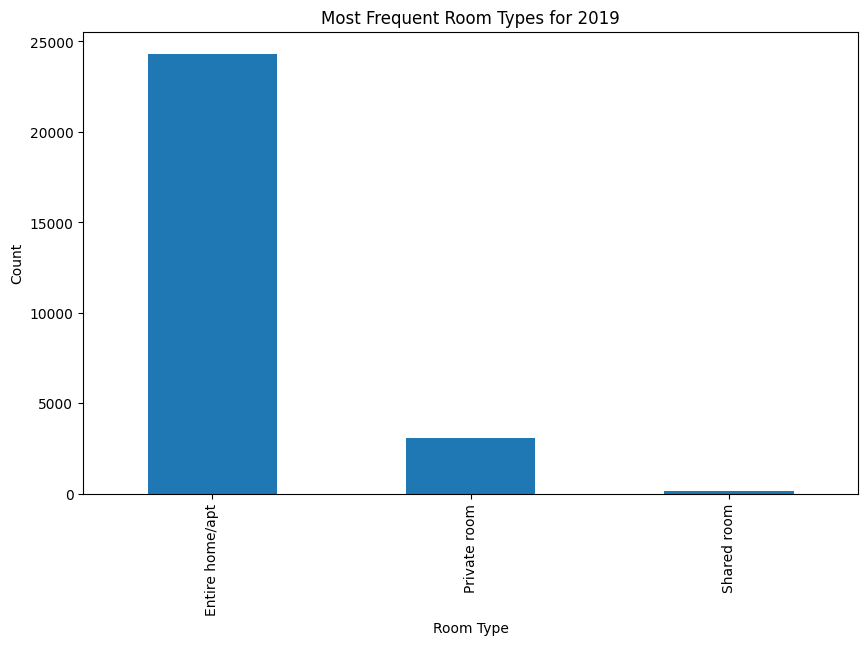

In [31]:
room_type_counts = train_2019['room_type'].value_counts()

# Εμφανίζουμε το γράφημα
room_type_counts.plot(kind='bar', xlabel='Room Type', ylabel='Count', title='Most Frequent Room Types for 2019', figsize=(10, 6))
plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



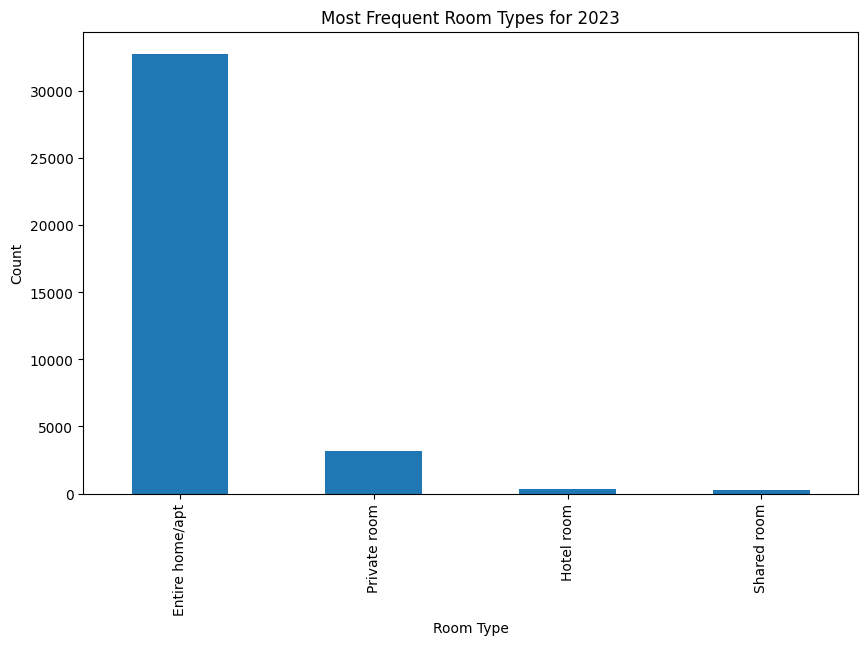

In [32]:
room_type_counts23 = train_2023['room_type'].value_counts()

# Εμφανίζουμε το γράφημα
room_type_counts23.plot(kind='bar', xlabel='Room Type', ylabel='Count', title='Most Frequent Room Types for 2023', figsize=(10, 6))
plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.2**

Φτιάξτε γράφημα που δείχνει την πορεία των τιμών για το διάστημα
των 3 μηνών.

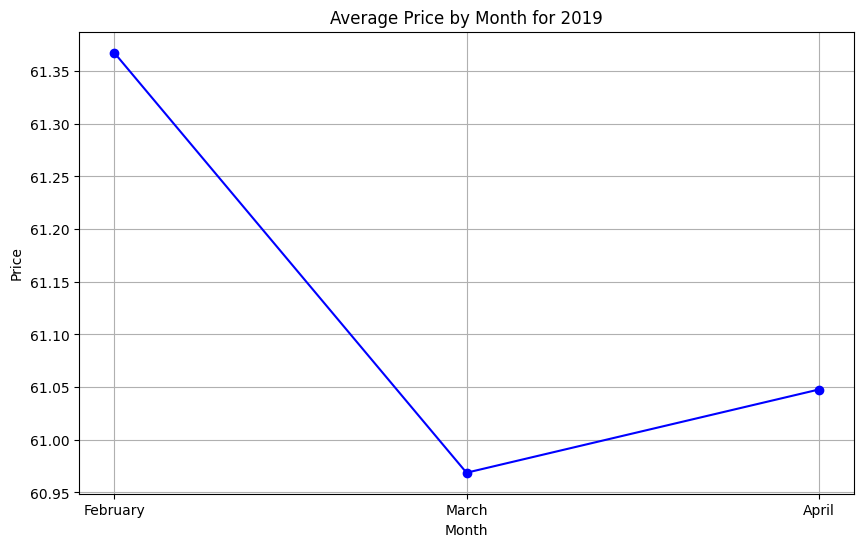

In [33]:
# Δημιουργούμε ένα αντίγραφο του αρχείου μας
copy_2019 = train_2019.copy()

# Αφαιρούμε το $ από την στήλη για να μπορέσουμε να το μετατρέψουμε σε τύπο δεδομένων αριθμών
copy_2019['price'] = copy_2019['price'].str.replace('$', '')

# Μετατρέπουμε την στήλη price σε τύπο δεδομένων αριθμών
copy_2019['price'] = pd.to_numeric(copy_2019['price'], errors='coerce')

average_price_by_month = copy_2019.groupby('month')['price'].mean()

# Εμγανίζουμε το γράφημα
average_price_by_month.plot(kind='line', marker='o', color='blue', figsize=(10, 6))
plt.title('Average Price by Month for 2019')
plt.xlabel('Month')
plt.ylabel('Price')
plt.xticks(range(len(average_price_by_month)), ['February', 'March', 'April'])
plt.grid(True)
plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023


---






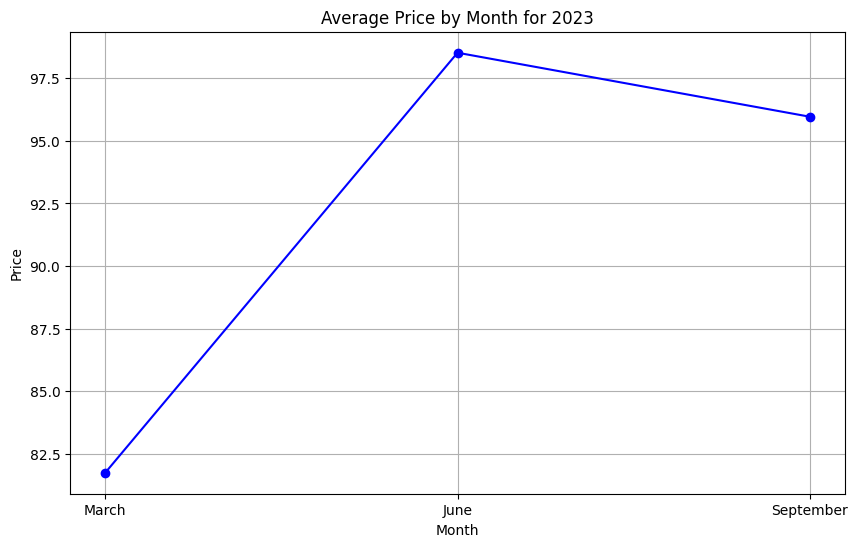

In [34]:
# Δημιουργούμε ένα αντίγραφο του αρχείου μας
copy_2023 = train_2023.copy()

# Αφαιρούμε το $ από την στήλη για να μπορέσουμε να το μετατρέψουμε σε τύπο δεδομένων αριθμών
copy_2023['price'] = copy_2023['price'].str.replace('$', '')

# Μετατρέπουμε την στήλη price σε τύπο δεδομένων αριθμών
copy_2023['price'] = pd.to_numeric(copy_2023['price'], errors='coerce')

average_price_by_month23 = copy_2023.groupby('month')['price'].mean()

# Εμγανίζουμε το γράφημα
average_price_by_month23.plot(kind='line', marker='o', color='blue', figsize=(10, 6))
plt.title('Average Price by Month for 2023')
plt.xlabel('Month')
plt.ylabel('Price')
plt.xticks(range(len(average_price_by_month23)), ['March', 'June', 'September'])
plt.grid(True)
plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.3**

Ποιές είναι οι 5 πρώτες γειτονιές με τις περισσότερες κριτικές;

In [35]:
neighborhood_reviews = train_2019.groupby('neighbourhood')['number_of_reviews'].sum()
neighborhood_reviews_sorted = neighborhood_reviews.sort_values(ascending=False)
top_5_neighborhoods = neighborhood_reviews_sorted.head(5)

print("Top 5 neighborhoods with the most reviews for 2019:")
print(top_5_neighborhoods)

Top 5 neighborhoods with the most reviews for 2019:
neighbourhood
Plaka           132354
Koukaki          89641
Neos Kosmos      83204
Psyri            54351
Metaxourgeio     44532
Name: number_of_reviews, dtype: int64


Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [36]:
neighborhood_reviews23 = train_2023.groupby('neighbourhood_cleansed')['number_of_reviews'].sum()
neighborhood_reviews_sorted23 = neighborhood_reviews23.sort_values(ascending=False)
top_5_neighborhoods23 = neighborhood_reviews_sorted23.head(5)

print("Top 5 neighborhoods with the most reviews for 2023:")
print(top_5_neighborhoods23)

Top 5 neighborhoods with the most reviews for 2023:
neighbourhood_cleansed
ΕΜΠΟΡΙΚΟ ΤΡΙΓΩΝΟ-ΠΛΑΚΑ              433507
ΚΟΥΚΑΚΙ-ΜΑΚΡΥΓΙΑΝΝΗ                 207147
ΝΕΟΣ ΚΟΣΜΟΣ                         129428
ΜΟΥΣΕΙΟ-ΕΞΑΡΧΕΙΑ-ΝΕΑΠΟΛΗ            103901
ΑΓΙΟΣ ΚΩΝΣΤΑΝΤΙΝΟΣ-ΠΛΑΤΕΙΑ ΒΑΘΗΣ    102836
Name: number_of_reviews, dtype: int64


**ΥΠΟΕΡΩΤΗΜΑ 1.4**

Ποιά είναι η γειτονιά με τις περισσότερες καταχωρήσεις ακινήτων;

In [37]:
neighborhood_real_estates = train_2019['neighbourhood'].value_counts()
most_real_estates_neighborhood = neighborhood_real_estates.idxmax()

print("The neighbourhood with the most real estates for 2019 is:", most_real_estates_neighborhood)

The neighbourhood with the most real estates for 2019 is: Plaka


Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [38]:
neighborhood_real_estates23 = train_2023['neighbourhood_cleansed'].value_counts()
most_real_estates_neighborhood23 = neighborhood_real_estates23.idxmax()

print("The neighbourhood with the most real estates for 2023 is:", most_real_estates_neighborhood23)

The neighbourhood with the most real estates for 2023 is: ΕΜΠΟΡΙΚΟ ΤΡΙΓΩΝΟ-ΠΛΑΚΑ


**ΥΠΟΕΡΩΤΗΜΑ 1.5**

Πόσες είναι οι καταχωρήσεις ανά γειτονιά και ανά μήνα;

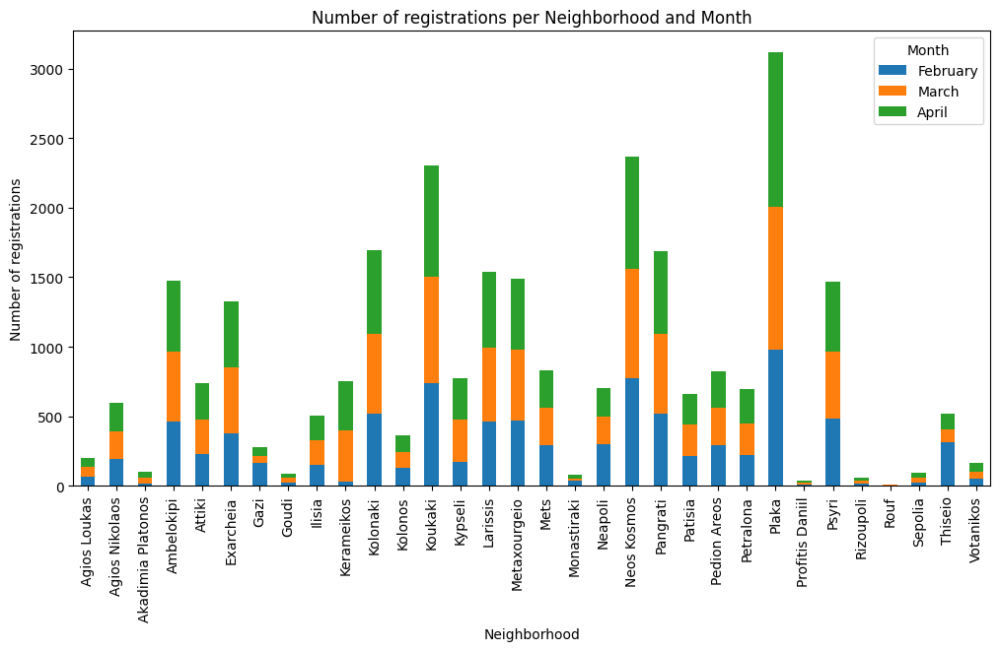

In [39]:
# Ομαδοποίηση ανά 'γειτονιά' και 'μήνα' και μέτρηση των εγγραφών
registrations_by_neighborhood_month = train_2019.groupby(['neighbourhood', 'month']).size().reset_index(name='registrations')

# Εμφανίζουμε το γράφημα
pivot_registrations_by_neighborhood_month = registrations_by_neighborhood_month.pivot(index='neighbourhood', columns='month', values='registrations')
pivot_registrations_by_neighborhood_month.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.xlabel('Neighborhood')
plt.ylabel('Number of registrations')
plt.title('Number of registrations per Neighborhood and Month')
plt.legend(title='Month')
plt.legend(title='Month', labels=['February', 'March', 'April'])

plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---


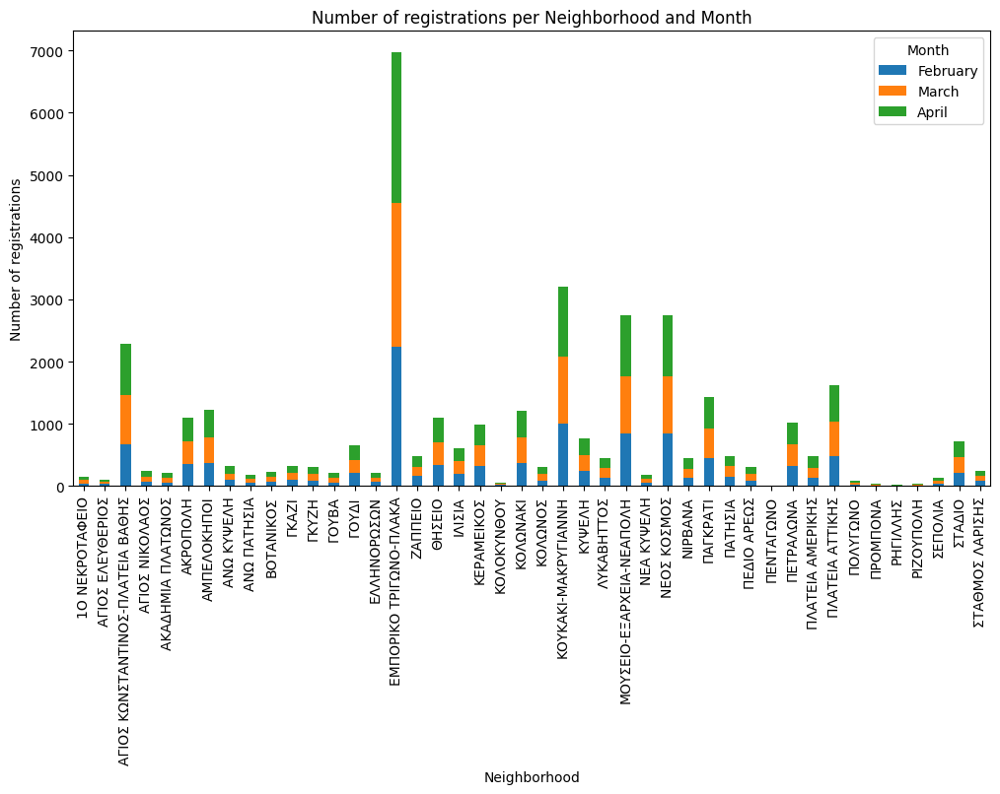

In [40]:
# Ομαδοποίηση ανά 'γειτονιά' και 'μήνα' και μέτρηση των εγγραφών
registrations_by_neighborhood_month23 = train_2023.groupby(['neighbourhood_cleansed', 'month']).size().reset_index(name='registrations')

# Εμφανίζουμε το γράφημα
pivot_registrations_by_neighborhood_month23 = registrations_by_neighborhood_month23.pivot(index='neighbourhood_cleansed', columns='month', values='registrations')
pivot_registrations_by_neighborhood_month23.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.xlabel('Neighborhood')
plt.ylabel('Number of registrations')
plt.title('Number of registrations per Neighborhood and Month')
plt.legend(title='Month')
plt.legend(title='Month', labels=['February', 'March', 'April'])

plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.6**

Σχεδιάστε το ιστόγραμμα της μεταβλητής neighborhood.

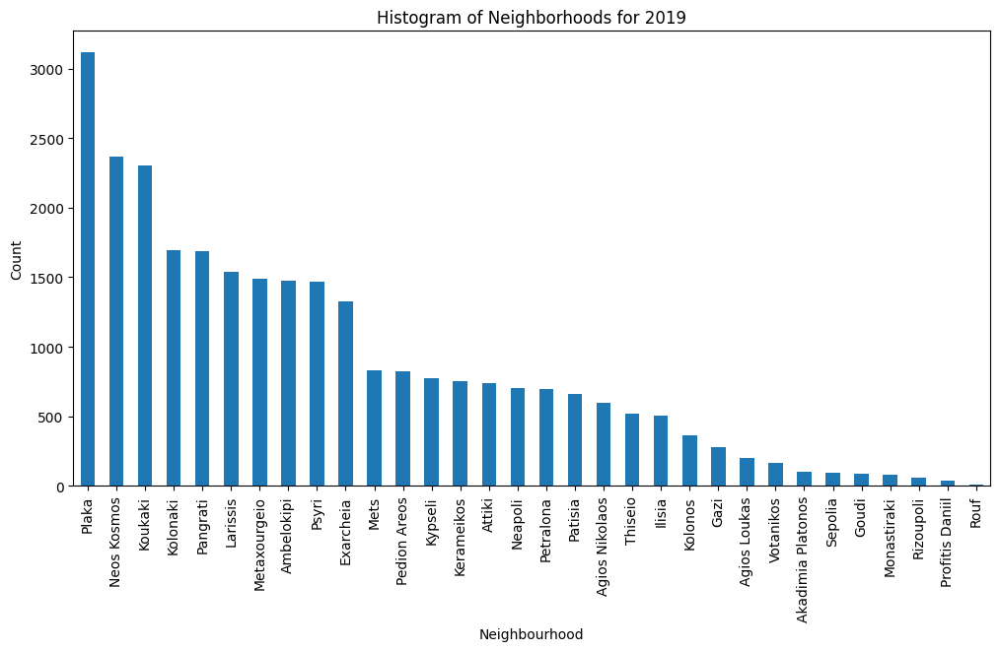

In [41]:
neighbourhood_counts = train_2019['neighbourhood'].value_counts()

# Εμφανίζουμε το γράφημα
neighbourhood_counts.plot(kind='bar', xlabel='Neighbourhood', ylabel='Count', title='Histogram of Neighborhoods for 2019', figsize=(12,6))
plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



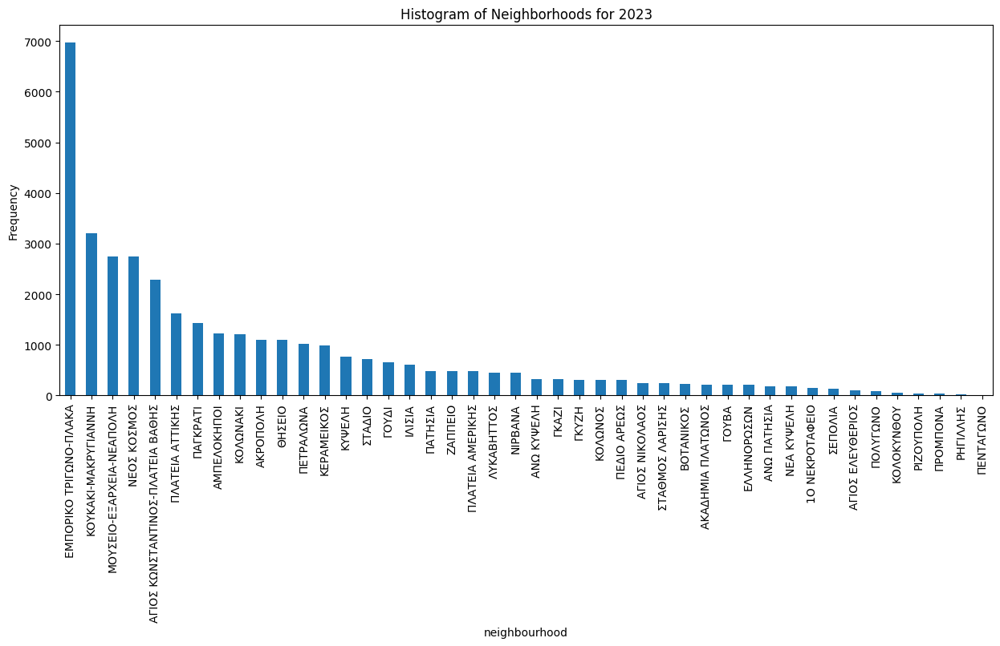

In [42]:
neighbourhood_counts23 = train_2023['neighbourhood_cleansed'].value_counts()

# Εμφανίζουμε το γράφημα
neighbourhood_counts23.plot(kind='bar', xlabel='neighbourhood', ylabel='Frequency', title='Histogram of Neighborhoods for 2023', figsize=(15, 6))
plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.7**

Ποιος είναι ο πιο συχνός τύπος δωματίου (room_type) σε κάθε γειτονιά
(neighborhood);

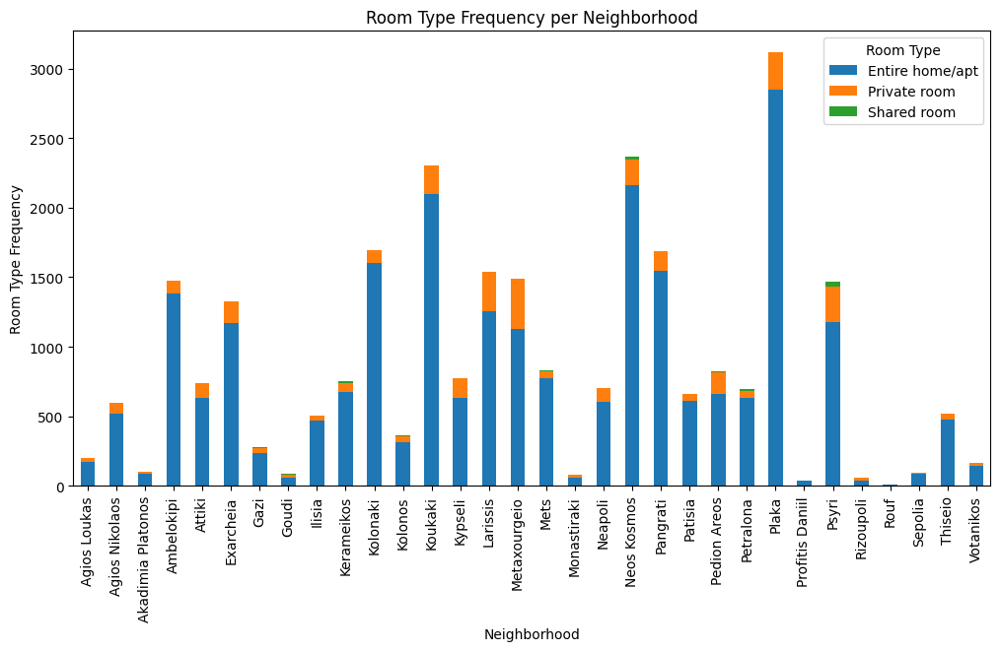

In [43]:
# Ομαδοποίηση ανά 'γειτονιά' και 'τύπο δωματίου' και μέτρηση των εμφανίσεων
room_type_counts_by_neighborhood = train_2019.groupby(['neighbourhood', 'room_type']).size().reset_index(name='room_type_frequency')

# Εμφάνιση του γραφήματος
pivot_room_type_per_neighbourhood = room_type_counts_by_neighborhood.pivot_table(index='neighbourhood', columns='room_type', values='room_type_frequency', fill_value=0)
pivot_room_type_per_neighbourhood.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.xlabel('Neighborhood')
plt.ylabel('Room Type Frequency')
plt.title('Room Type Frequency per Neighborhood')
plt.legend(title='Room Type')

plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



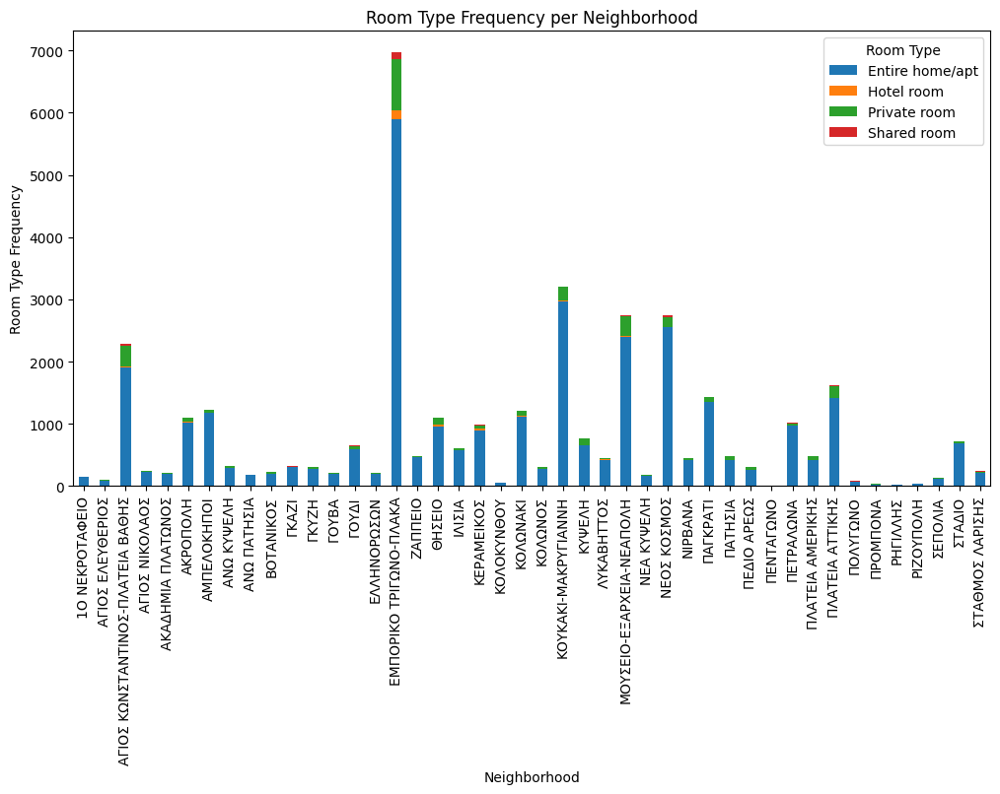

In [44]:
# Ομαδοποίηση ανά 'γειτονιά' και 'τύπο δωματίου' και μέτρηση των εμφανίσεων
room_type_counts_by_neighborhood23 = train_2023.groupby(['neighbourhood_cleansed', 'room_type']).size().reset_index(name='room_type_frequency')

# Εμφάνιση του γραφήματος
pivot_room_type_per_neighbourhood23 = room_type_counts_by_neighborhood23.pivot_table(index='neighbourhood_cleansed', columns='room_type', values='room_type_frequency', fill_value=0)
pivot_room_type_per_neighbourhood23.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.xlabel('Neighborhood')
plt.ylabel('Room Type Frequency')
plt.title('Room Type Frequency per Neighborhood')
plt.legend(title='Room Type')

plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.8**

Ποιός είναι ο πιο ακριβός τύπος δωματίου;

In [45]:
# Ομαδοποίηση ανά 'τύπο δωματίου' και υπολογισμός της μέσης τιμής για κάθε τύπο δωματίου
most_expensive_room_type = copy_2019.groupby('room_type')['price'].mean().idxmax()

print("The most expensive room type for 2019 is :", most_expensive_room_type )

The most expensive room type for 2019 is : Entire home/apt


Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [46]:
# Ομαδοποίηση ανά 'τύπο δωματίου' και υπολογισμός της μέσης τιμής για κάθε τύπο δωματίου
most_expensive_room_type23 = copy_2023.groupby('room_type')['price'].mean().idxmax()

print("The most expensive room type for 2023 is :", most_expensive_room_type23 )

The most expensive room type for 2023 is : Hotel room


**ΥΠΟΕΡΩΤΗΜΑ 1.9**

Χρησιμοποιήστε τις στήλες latitude/longitude και
εμφανίστε σε ένα χάρτη για ένα μήνα της επιλογής σας τα ακίνητα και στα popup στον χάρτη επιλέξτε όποια άλλη πληροφορία θέλετε να εμφανίζεται για το ακίνητο.

In [47]:
# Βρίσκουμε τον μέσο όρο του γεωγραφικύ πλάτους και γεωγραφικού μήκους
mean_lat = train_2019['latitude'].mean()
mean_lon = train_2019['longitude'].mean()

# Δημιουργούμε τον χάρτη με κέντρο τις μέσες τιμές
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=1000)

# Μετατρέπουμε τους μήνες σε αριθμούς
copy_2019['month'] = pd.to_numeric(copy_2019['month'], errors='coerce')
one_month = copy_2019[copy_2019['month'] == 2]

# Προσθήκη δεικτών για κάθε τοποθεσία καταλύματος
for idx, row in one_month.iterrows():
    folium.Marker([row['latitude'], row['longitude']],
                  popup=f"Price: {row['price']}").add_to(m)
m

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [48]:
# Βρίσκουμε τον μέσο όρο του γεωγραφικύ πλάτους και γεωγραφικού μήκους
mean_lat23 = train_2023['latitude'].mean()
mean_lon23 = train_2023['longitude'].mean()

# Δημιουργούμε τον χάρτη με κέντρο τις μέσες τιμές
m23 = folium.Map(location=[mean_lat23, mean_lon23], zoom_start=1000)

# Μετατρέπουμε τους μήνες σε αριθμούς
copy_2023['month'] = pd.to_numeric(copy_2023['month'], errors='coerce')
one_month23 = copy_2023[copy_2023['month'] == 6]

# Προσθήκη δεικτών για κάθε τοποθεσία καταλύματος
for idx, row in one_month23.iterrows():
    folium.Marker([row['latitude'], row['longitude']],
                  popup=f"Price: {row['price']}").add_to(m23)
m23

**ΥΠΟΕΡΩΤΗΜΑ 1.10**

 Φτιάξτε διαφορετικά wordclouds με τα δεδομένα από τη στήλη neighbourhood,
transit, description και τη στήλη comments από το αρχείο reviews.csv.

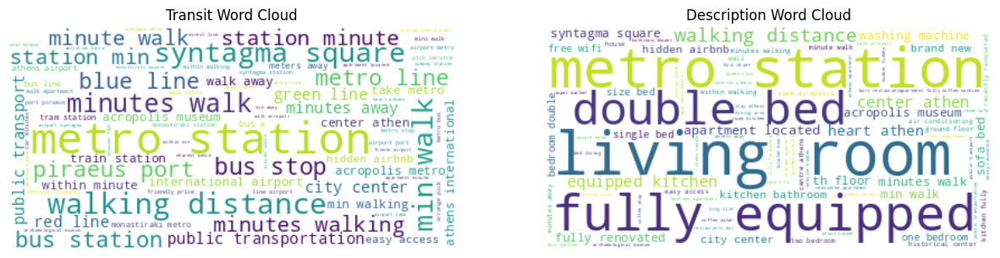

In [49]:
stop_words = set(stopwords.words('english'))

def clean_text(text):
    # Διατηρούμε μόνο γράμματα και κενά και τα μετατρέπουμε σε μικρούς χαρακτήρες
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', str(text))
    cleaned_text = cleaned_text.lower()
    # Χρησιμοποιούμε την regex για να αντικαταστήσετε τους ειδικούς χαρακτήρες με κενό string
    cleaned_text = re.sub(r'\s+', ' ', cleaned_text).strip()
    # Αφαιρούμε τα stopwords
    words = cleaned_text.split()
    filtered_words = [word for word in words if word not in stop_words]
    # Ενώνουμε τις φιλτραρισμένες λέξεις πίσω σε ένα string
    cleaned_text = ' '.join(filtered_words)
    return cleaned_text

train_2019['cleaned_decription'] = train_2019['description'].apply(clean_text)
train_2019['cleaned_transit'] = train_2019['transit'].replace('Note:','')
train_2019['cleaned_transit'] = train_2019['transit'].apply(clean_text)

# Δημιουργούμε το WordCloud για την στήλη transit
transit_cloud = WordCloud(background_color='white').generate(' '.join(train_2019['cleaned_transit']))

# Δημιουργούμε το WordCloud για την στήλη description
description_cloud = WordCloud(background_color='white').generate(' '.join(train_2019['cleaned_decription']))

# Εμφανίζουμε τα WordClouds
plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
plt.imshow(transit_cloud, interpolation='bilinear')
plt.title('Transit Word Cloud')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(description_cloud, interpolation='bilinear')
plt.title('Description Word Cloud')
plt.axis('off')

plt.show()

In [50]:
reviewsFeb19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/febrouary/reviews.csv')
reviewsMarch19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/march/reviews.csv')
reviewsApril19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/april/reviews.csv')

reviews_2019 = pd.concat([reviewsFeb19, reviewsMarch19, reviewsApril19], ignore_index=False)
reviews_2019 = reviews_2019.sample(frac=0.5, random_state=42)

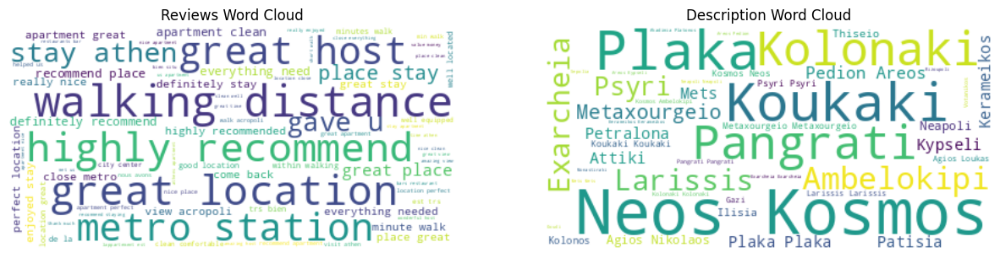

In [51]:
stop_words = set(stopwords.words('english'))
def clean_text(text):
    # Διατηρούμε μόνο γράμματα και κενά και τα μετατρέπουμε σε μικρούς χαρακτήρες
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', str(text))
    cleaned_text = cleaned_text.lower()
    # Χρησιμοποιούμε την regex για να αντικαταστήσετε τους ειδικούς χαρακτήρες με κενό string
    cleaned_text = re.sub(r'\s+', ' ', cleaned_text).strip()
    # Αφαιρούμε τα stopwords
    words = cleaned_text.split()
    filtered_words = [word for word in words if word not in stop_words]
    # Ενώνουμε τις φιλτραρισμένες λέξεις πίσω σε ένα string
    cleaned_text = ' '.join(filtered_words)
    return cleaned_text

reviews_2019['comments'] = reviews_2019['comments'].apply(clean_text)

# Δημιουργούμε το WordCloud για την στήλη transit
reviews_cloud = WordCloud(background_color='white').generate(' '.join(reviews_2019['comments']))

# Δημιουργούμε το WordCloud για την στήλη description
neighbourhood_cloud = WordCloud(background_color='white').generate(' '.join(train_2019['neighbourhood']))

# Εμφανίζουμε τα WordClouds
plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
plt.imshow(reviews_cloud, interpolation='bilinear')
plt.title('Reviews Word Cloud')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(neighbourhood_cloud, interpolation='bilinear')
plt.title('Description Word Cloud')
plt.axis('off')

plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



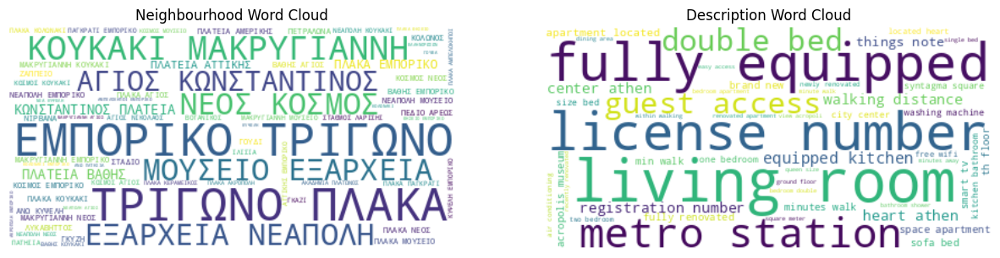

In [52]:
stop_words = set(stopwords.words('english'))
def clean_text(text):
    # Διατηρούμε μόνο γράμματα και κενά και τα μετατρέπουμε σε μικρούς χαρακτήρες
    text = re.sub(r'\b(b|br|brbr)\b', '', text)
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', str(text))
    cleaned_text = cleaned_text.lower()
    # Χρησιμοποιούμε την regex για να αντικαταστήσετε τους ειδικούς χαρακτήρες με κενό string
    cleaned_text = re.sub(r'\s+', ' ', cleaned_text).strip()
    # Αφαιρούμε τα stopwords
    words = cleaned_text.split()
    filtered_words = [word for word in words if word not in stop_words]
    # Ενώνουμε τις φιλτραρισμένες λέξεις πίσω σε ένα string
    cleaned_text = ' '.join(filtered_words)
    return cleaned_text

train_2023['cleaned_decription'] = train_2023['description'].apply(clean_text)

# Δημιουργούμε το WordCloud για την στήλη description
description_cloud23 = WordCloud(background_color='white').generate(' '.join(train_2023['cleaned_decription']))

# Δημιουργούμε το WordCloud για την στήλη description
neighbourhood_cloud23 = WordCloud(background_color='white').generate(' '.join(train_2023['neighbourhood_cleansed']))

# Εμφανίζουμε τα WordClouds
plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
plt.imshow(neighbourhood_cloud23, interpolation='bilinear')
plt.title('Neighbourhood Word Cloud')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(description_cloud23, interpolation='bilinear')
plt.title('Description Word Cloud')
plt.axis('off')

plt.show()

In [53]:
reviewsMarch23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/march/reviews.csv')
reviewsJune23= pd.read_csv('/content/gdrive/MyDrive/data/data/2023/june/reviews.csv')
reviewsSept23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/september/reviews.csv')

reviews_2023 = pd.concat([reviewsMarch23, reviewsJune23, reviewsSept23], ignore_index=False)
reviews_2023 = reviews_2023.sample(frac=0.5, random_state=42)

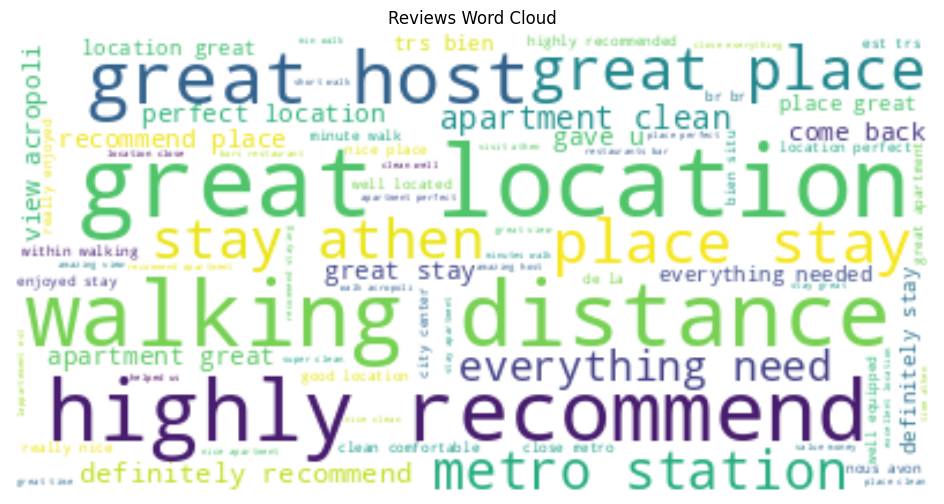

In [54]:
stop_words = set(stopwords.words('english'))
def clean_text(text):
    # Διατηρούμε μόνο γράμματα και κενά και τα μετατρέπουμε σε μικρούς χαρακτήρες
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', str(text))
    cleaned_text = cleaned_text.lower()
    # Χρησιμοποιούμε την regex για να αντικαταστήσετε τους ειδικούς χαρακτήρες με κενό string
    cleaned_text = re.sub(r'\s+', ' ', cleaned_text).strip()
    # Αφαιρούμε τα stop
    words = cleaned_text.split()
    filtered_words = [word for word in words if word not in stop_words]
    # Ενώνουμε τις φιλτραρισμένες λέξεις πίσω σε ένα string
    cleaned_text = ' '.join(filtered_words)
    return cleaned_text

reviews_2023['comments'] = reviews_2023['comments'].apply(clean_text)

# Δημιουργούμε το WordCloud για την στήλη transit
reviews_cloud23 = WordCloud(background_color='white').generate(' '.join(reviews_2023['comments']))
# Εμφανίζουμε τα WordClouds
plt.figure(figsize=(15, 6))

plt.imshow(reviews_cloud23, interpolation='bilinear')
plt.title('Reviews Word Cloud')
plt.axis('off')

plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.11**

Αντικαταστήστε τα στοιχεία στην στήλη amenities με την κατηγορία που ανήκουν

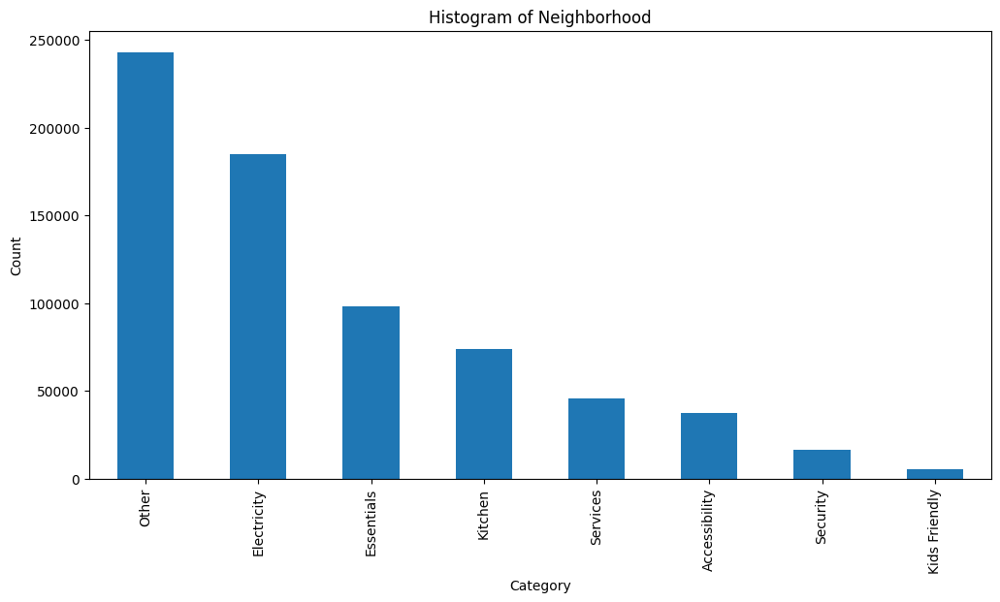

In [55]:
# Πρώτα θα βρούμε τις πιο συχνά χρησιμοποιούμενες λέξεις και πόσες φορές εμφανίζονται στη στήλη
words = []
for index, row in train_2019.iterrows():
    text = row['amenities']
    # Χωρίστε το συμβολοσειρά σε λέξεις μεταξύ κομμάτων
    words.extend(text.split(','))

cleaned_words = []
for word in words:
    cleaned_word = re.sub(r'[^\w\s]', '', word)
    cleaned_word = re.sub(r'\s+', ' ', cleaned_word)  # Αντικαταστήστε συνεχόμενα κενά με ένα μόνο κενό
    cleaned_words.append(cleaned_word.strip())

# Μετράμε την συχνότητα των λέξεων
word_counts = Counter(cleaned_words)
most_common_words = word_counts.most_common(100)

# Δημιουργούμε το λεξικό
categories = {
    'Essentials': ['Hangers','Shampoo', 'Hot water', 'First aid kit', 'Bed linens', 'Handheld shower head', 'toilet'],
    'Kitchen': ['Dishes and silverware', 'Cooking basics', 'Coffee maker', 'Oven', 'Microwave', 'Dishwasher', 'Stove'],
    'Electricity': ['Air conditioning', 'Hair dryer', 'Heating', 'Wifi', 'TV', 'Iron', 'Washer', 'Refrigerator', 'Cable TV', 'Buzzer/wireless intercom', 'Ethernet connection'],
    'Accessibility': ['Elevator', 'Step-free access', 'Wide doorway', 'Well-lit path to entrance', 'Accessible-height bed', 'Wide clearance to bed', 'Wide hallway clearance', 'Wide clearance to shower', 'Flat path to front door', 'Wheelchair accessible'],
    'Security': ['Fire extinguisher', 'Lockbox', 'Window guards'],
    'Kids Friendly': ['Family/kid friendly', 'Crib', 'Children’s dinnerware', 'Outlet covers', 'Pack ’n Play/travel crib', 'Baby bath'],
    'Services': ['Long term stays allowed', 'Host greets you', 'Luggage dropoff allowed', 'Single level home', 'Private living room', 'Indoor fireplace', 'Building staff', 'Cleaning before checkout', 'Hot tub', 'Childrens books and toys', 'Breakfast', '24-hour check-in', 'Paid parking on premises', 'Suitable for events'],
    'Other': ['Laptop friendly workspace', 'Patio or balcony', 'Long term stays allowed', 'Extra pillows and blankets', 'Lock on bedroom door', 'Smoke detector', 'Safety card', 'Room-darkening shades', 'Childrens books and toys', 'High chair', 'Paid parking off premises', 'Smoking allowed', 'Private entrance', 'Carbon monoxide detector', 'Self check-in', 'Pets allowed', 'Wide entryway', 'Free parking on premises', 'Babysitter recommendations', 'Garden or backyard', 'Keypad', 'Bedroom comforts']
}
categories['Other'] += cleaned_words[100:]

categories_replaced = []
# Διασχίζουμε όλες τις λέξεις στην λίστα cleaned_words
for word in cleaned_words:
    #print(word)
    for category, word_list in categories.items():
        # Ελέγχουμε αν μία λέξη ανήκει σε καμιά κατηγορία
        if word in word_list:
            #print(category)
            # Αντικαθηστούμε την λέξη με την κατηγορία
            categories_replaced.append(category)
            break

# Το μετατρέπουμε σε dataframe για να το κάνουμε γράφημα
df = pd.DataFrame(categories_replaced, columns=['Category'])

diagram = df['Category'].value_counts()
diagram.plot(kind='bar', figsize=(12, 6))
plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Histogram of Neighborhood')

plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



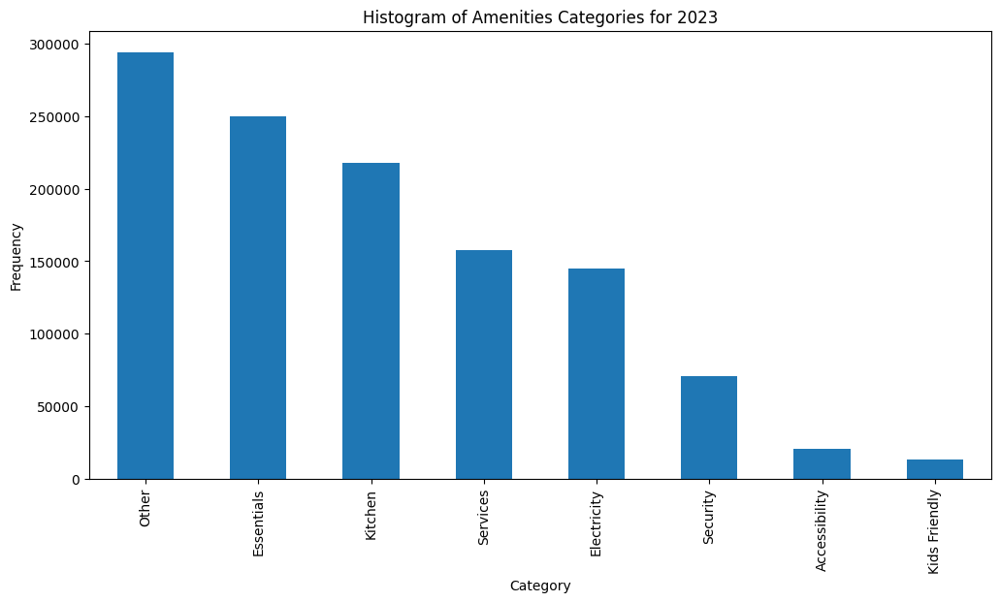

In [56]:
# Πρώτα θα βρούμε τις πιο συχνά χρησιμοποιούμενες λέξεις και πόσες φορές εμφανίζονται στη στήλη
words23 = []
for index, row in train_2023.iterrows():
    text = row['amenities']
    # Χωρίστε το συμβολοσειρά σε λέξεις μεταξύ κομμάτων
    words23.extend(text.split(','))

cleaned_words23 = []
for word in words23:
    cleaned_word23 = re.sub(r'[^\w\s]', '', word)
    cleaned_word23 = re.sub(r'\s+', ' ', cleaned_word23)  # Αντικαταστήστε συνεχόμενα κενά με ένα μόνο κενό
    cleaned_words23.append(cleaned_word23.strip())

# Μετράμε την συχνότητα των λέξεων
word_counts23 = Counter(cleaned_words23)
most_common_words23 = word_counts23.most_common(100)

# Δημιουργούμε το λεξικό
categories23 = {
    "Electricity": ["Wifi", "Hair dryer", "Iron", "TV", "Washer", "Free washer – In unit", "Free dryer – In unit", "Electric stove", "AC split type ductless system", "Window AC unit", "Stainless steel oven", "Standard cable"],
    "Kids Friendly": ["Crib", "High chair", "Children's books and toys", "Children's dinnerware", "Crib available upon request"],
    "Services": ["Long term stays allowed", "Self checkin", "Extra pillows and blankets", "Dedicated workspace", "Free street parking", "Private patio or balcony", "Lockbox", "Luggage dropoff allowed", "Private entrance", "Host greets you", "Pets allowed", "Cleaning available during stay", "Babysitter recommendations", "Breakfast", "Free parking on premises", "Portable fans"],
    "Security": ["Fire extinguisher", "First aid kit", "Safe", "Security cameras on property", "Lock on bedroom door", "Carbon monoxide alarm", "Smoke alarm"],
    "Kitchen": ["Kitchen", "Dishes and silverware", "Cooking basics", "Refrigerator", "Hot water kettle", "Oven", "Coffee maker", "Microwave", "Coffee", "Wine glasses", "Coffee maker drip coffee maker", "Blender", "Coffee maker espresso machine", "Nespresso"],
    "Essentials": ["Essentials", "Hangers", "Hot water", "Shampoo", "Bed linens", "Air conditioning", "Heating", "Shower gel", "Body soap", "Bathtub", "Clothing storage wardrobe", "AC split type ductless system", "Central heating", "Heating split type ductless system", "Clothing storage", "Clothing storage closet"],
    "Accessibility": ["Elevator", "High chair"],
    "Other": ["Cleaning products", "Roomdarkening shades", "Dining table", "Outdoor furniture", "Ethernet connection", "Laundromat nearby", "Paid parking off premises", "Paid parking garage off premises", "Pack 'n play/Travel crib", "Books and reading material", "Keypad", "Mosquito net", "Breakfast", "Backyard"]
}
categories23['Other'] += cleaned_words23[100:]

categories_replaced23 = []
# Διασχίζουμε όλες τις λέξεις στην λίστα cleaned_words
for word in cleaned_words23:
    for category, word_list in categories23.items():
        # Ελέγχουμε αν μία λέξη ανήκει σε καμιά κατηγορία
        if word in word_list:
            # Αντικαθηστούμε την λέξη με την κατηγορία
            categories_replaced23.append(category)
            break

# Το μετατρέπουμε σε dataframe για να το κάνουμε γράφημα
df23 = pd.DataFrame(categories_replaced23, columns=['category'])

diagram = df23['category'].value_counts()
diagram.plot(kind='bar', figsize=(12, 6))
plt.title('Histogram of Amenities Categories for 2023')
plt.xlabel('Category')
plt.ylabel('Frequency')
plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.12**

Υπολογίστε αρχικά την μέση τιμή ανα γειτονιά, για τα δωμάτια που
επιτρέπουν φιλοξενία δύο ατόμων. Δείξτε σε ένα γράφημα τις γειτονιές ταξινομημένες ανάλογα με την μέση τιμή τους. Στην συνέχεια κατατάξτε τις γειτονιές σε 3 ομάδες ανάλογα με την μέση τιμή των δωματίων.

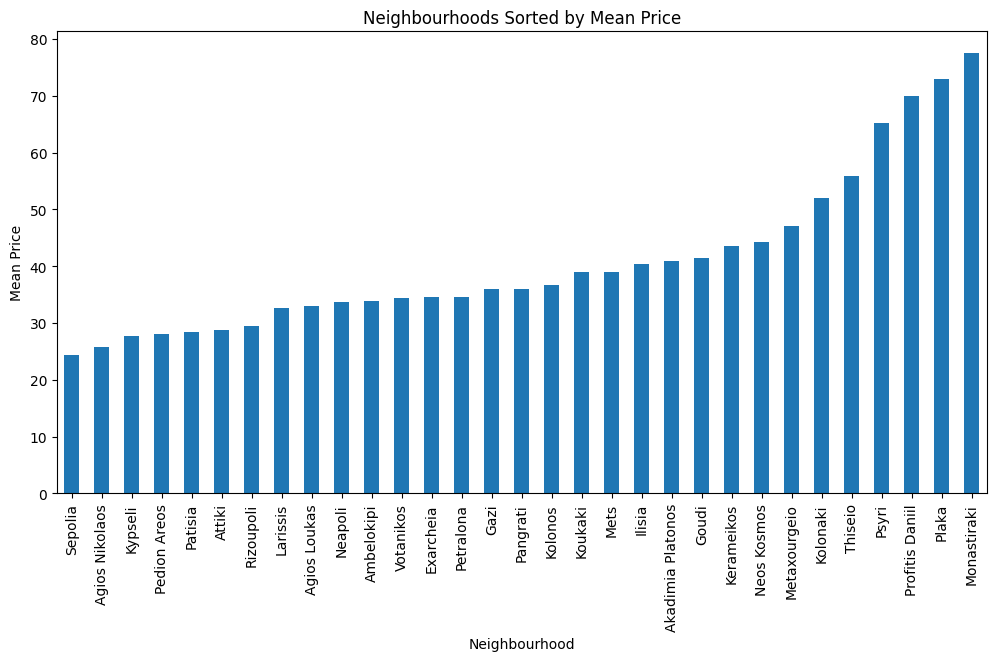

In [57]:
mean_price_by_neighborhood = copy_2019[copy_2019['accommodates'] == 2].groupby('neighbourhood')['price'].mean()
mean_price_by_neighborhood = mean_price_by_neighborhood.sort_values()

mean_price_by_neighborhood.plot(kind='bar',figsize=(12, 6))
plt.xlabel('Neighbourhood')
plt.ylabel('Mean Price')
plt.title('Neighbourhoods Sorted by Mean Price')
plt.show()

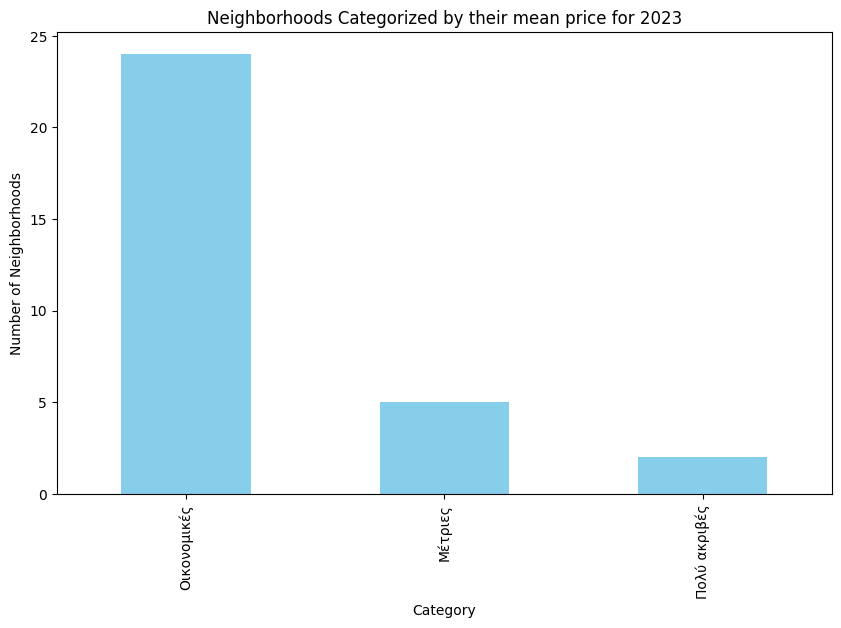

In [58]:
def categorize_neighborhood(price):
    if price > 70:
        return 'Πολύ ακριβές'
    elif price > 45:
        return 'Μέτριες'
    else:
        return 'Οικονομικές'

categorized_neighborhoods = mean_price_by_neighborhood.apply(categorize_neighborhood)

categorized_neighborhoods.value_counts().plot(kind='bar', color='skyblue', figsize=(10, 6))
plt.xlabel('Category')
plt.ylabel('Number of Neighborhoods')
plt.title('Neighborhoods Categorized by their mean price for 2023')
plt.show()

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



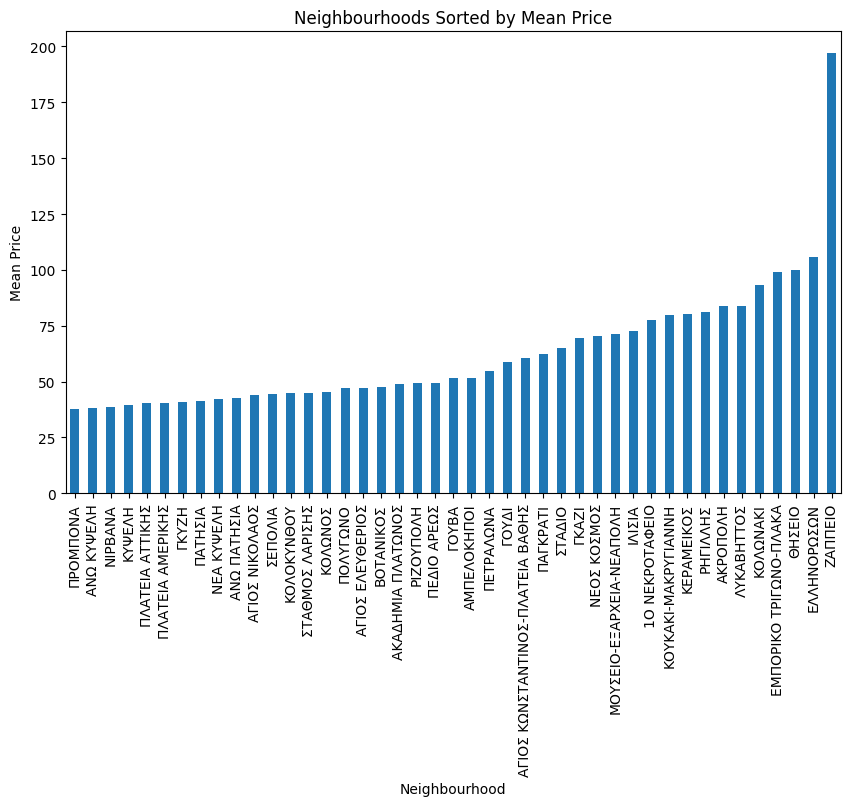

In [59]:
mean_price_by_neighborhood23 = copy_2023[copy_2023['accommodates'] == 2].groupby('neighbourhood_cleansed')['price'].mean()
mean_price_by_neighborhood23 = mean_price_by_neighborhood23.sort_values()

mean_price_by_neighborhood23.plot(kind='bar', figsize=(10, 6))
plt.xlabel('Neighbourhood')
plt.ylabel('Mean Price')
plt.title('Neighbourhoods Sorted by Mean Price')
plt.show()

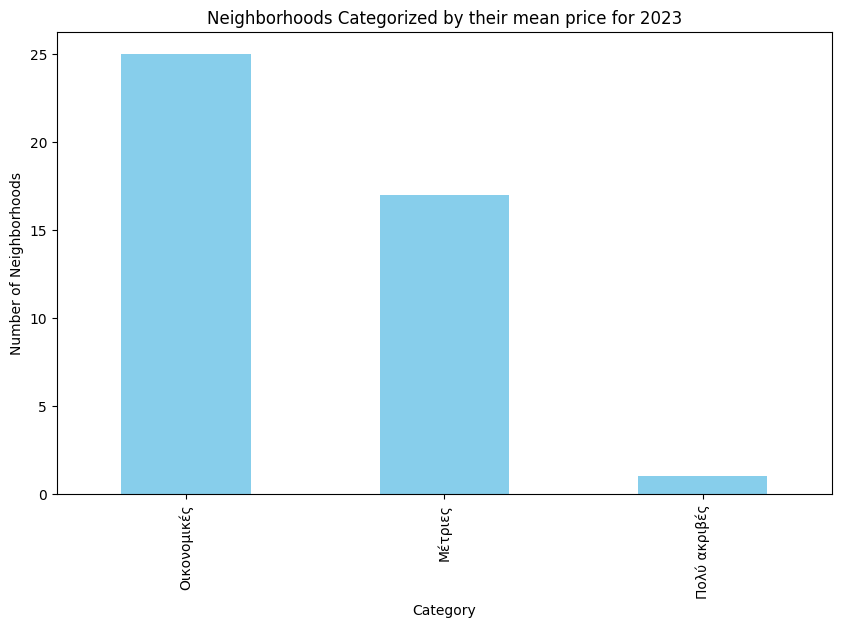

In [60]:
def categorize_neighborhood(price):
    if price > 120:
        return 'Πολύ ακριβές'
    elif price > 60:
        return 'Μέτριες'
    else:
        return 'Οικονομικές'

categorized_neighborhoods23 = mean_price_by_neighborhood23.apply(categorize_neighborhood)

categorized_neighborhoods23.value_counts().plot(kind='bar', color='skyblue', figsize=(10, 6))
plt.xlabel('Category')
plt.ylabel('Number of Neighborhoods')
plt.title('Neighborhoods Categorized by their mean price for 2023')
plt.show()

**ΥΠΟΕΡΩΤΗΜΑ 1.13.1**

Η απόσταση ενός σπιτιού από την Ακρόπολη επηρεάζει την τιμή του;

In [61]:
# Οι γεογραφικές συντεταγμένες της Ακρόπολης
Acropolis = (37.970833, 23.726110)
distance = 0
close_to_acropolis = []

# Επαναλαμβάνουμε όλες τις σειρές στο πλαίσιο δεδομένων
for index, row in train_2019.iterrows():
    geo_location = (row['latitude'], row['longitude'])
    distance = GD(Acropolis, geo_location).km
    if row['accommodates'] == 2 and distance < 1:
      price = row['price']
      price = float(price.replace(',', '').replace('$', ''))
      close_to_acropolis.append(price)

mean_price_close_to_acropolis = np.mean(close_to_acropolis)
mean_price = copy_2019['price'].mean()

if mean_price_close_to_acropolis > mean_price:
  print("If a listing is close to acropolis it has a trend to increase its price since the average price of all listings is", mean_price)
  print("while close to acropolis it is ", mean_price_close_to_acropolis)
else:
  print("The distance from Acropolis is irrelevant to the price of a listing")

If a listing is close to acropolis it has a trend to increase its price since the average price of all listings is 61.122692251780784
while close to acropolis it is  86.38434163701068


Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [62]:
# Οι γεογραφικές συντεταγμένες της Ακρόπολης
Acropolis = (37.970833, 23.726110)
distance = 0
close_to_acropolis = []

# Επαναλαμβάνουμε όλες τις σειρές στο πλαίσιο δεδομένων
for index, row in train_2023.iterrows():
    geo_location = (row['latitude'], row['longitude'])
    distance = GD(Acropolis, geo_location).km
    if row['accommodates'] == 2 and distance < 1:
      price = row['price']
      price = float(price.replace(',', '').replace('$', ''))
      close_to_acropolis.append(price)

mean_price_close_to_acropolis = np.mean(close_to_acropolis)
mean_price = copy_2023['price'].mean()

if mean_price_close_to_acropolis > mean_price:
  print("If a listing is close to acropolis it has a trend to increase its price since the average price of all listings is", mean_price)
  print("while close to acropolis it is ", mean_price_close_to_acropolis)
else:
  print("The distance from Acropolis is irrelevant to the price of a listing")

If a listing is close to acropolis it has a trend to increase its price since the average price of all listings is 92.41482091395636
while close to acropolis it is  108.83549295774648


**ΕΡΩΤΗΜΑ 1.13.2**

Βρίσκουμε πόσα σπίτια υπάρχουν που μπορούν να φιλοξενήσουν παραπάνω απο 10 άτομα και κοστίζουν λιγότερτα από 100 ευρώ

In [63]:
accommodate_more_than_10_and_less_than_100_euro = copy_2019[(copy_2019['price']<100)&(copy_2019['accommodates']>10)]

print("Number of apartments that can accommodate more than 10 people and cost less than 100 euro:", len(accommodate_more_than_10_and_less_than_100_euro))

print("IDs of apartments that can accommodate more than 10 people and cost less than 100 euro:")
print(accommodate_more_than_10_and_less_than_100_euro['id'].tolist())

Number of apartments that can accommodate more than 10 people and cost less than 100 euro: 117
IDs of apartments that can accommodate more than 10 people and cost less than 100 euro:
[661776, 1164882, 2677855, 7839356, 11599860, 14477259, 15836230, 16400746, 18271074, 18671390, 19571534, 21138599, 22789474, 22803785, 25625786, 26118937, 27757170, 28161133, 28889428, 28912784, 29002241, 29097090, 29118807, 29119475, 29275508, 29358454, 29358857, 29472612, 29499820, 29500057, 29500094, 30012109, 30087925, 30339322, 31051570, 31847945, 1164882, 2677855, 7839356, 11599860, 14477259, 15836230, 16400746, 18271074, 18671390, 19571534, 21138599, 22803785, 24353129, 25625786, 26118937, 27757170, 28889428, 28912784, 29002241, 29118807, 29119475, 29358454, 29358857, 29472612, 29499820, 30012109, 30087925, 30339322, 31051570, 31847945, 32273885, 32356546, 32434173, 32460851, 1164882, 2677855, 7839356, 11599860, 14477259, 15836230, 16400746, 18271074, 18671390, 19571534, 21138599, 21349347, 2280378

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [64]:
accommodate_more_than_10_and_less_than_100_euro23 = copy_2023[(copy_2023['price']<100)&(copy_2023['accommodates']>10)]

print("Number of apartments that can accommodate more than 10 people and cost less than 100 euro:", len(accommodate_more_than_10_and_less_than_100_euro23))

print("IDs of apartments that can accommodate more than 10 people and cost less than 100 euro:")
print(accommodate_more_than_10_and_less_than_100_euro23['id'].tolist())

Number of apartments that can accommodate more than 10 people and cost less than 100 euro: 16
IDs of apartments that can accommodate more than 10 people and cost less than 100 euro:
[12692563, 19571534, 24459446, 29089955, 38507975, 630075372037165646, 650692529377793181, 743449308051208022, 19571534, 38507975, 536951678692771746, 743449308051208022, 863076519278340644, 12692563, 38507975, 743449308051208022]


**ΕΡΩΤΗΜΑ 1.13.3**

Βρίσκουμε πόσα και ποιά σπίτια έχουν πάνω από 100 κριτικές και ο μέσος όρος των κριτικων τους είναι πάνω από 90%

In [65]:
apartments_with_more_than_100_rewies_and_over_90_rating = train_2019[(train_2019['review_scores_rating'] > 90) & (train_2019['number_of_reviews'] >= 100)]

print("Number of apartments with more than 100 reviews and at least 90% score rating:", len(apartments_with_more_than_100_rewies_and_over_90_rating))

print("IDs of apartments with more than 100 reviews and at least 90% score rating:")
print(apartments_with_more_than_100_rewies_and_over_90_rating['id'].tolist())

Number of apartments with more than 100 reviews and at least 90% score rating: 2221
IDs of apartments with more than 100 reviews and at least 90% score rating:
[28186, 44858, 49489, 59663, 80598, 81230, 119682, 154243, 157869, 222637, 306234, 309315, 348513, 350321, 361393, 401423, 408907, 474719, 484925, 526273, 567938, 571876, 590287, 593916, 631150, 631281, 644785, 661314, 661776, 674018, 695173, 702480, 711554, 724485, 727374, 728383, 752058, 776499, 783657, 800755, 896212, 905315, 906698, 918776, 918812, 956127, 993583, 1050677, 1094063, 1122600, 1154316, 1164882, 1177492, 1207614, 1208210, 1214643, 1215055, 1216176, 1223199, 1232279, 1259830, 1284153, 1368303, 1369908, 1374299, 1447443, 1484797, 1499953, 1529526, 1587347, 1728675, 1734269, 1743425, 1746907, 1751520, 1826249, 1843759, 1845240, 2108703, 2133917, 2202169, 2240132, 2264636, 2299339, 2305770, 2362698, 2428866, 2439063, 2487816, 2513822, 2551382, 2554765, 2569341, 2579525, 2582678, 2610077, 2612931, 2618140, 2630315, 2

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [66]:
apartments_with_more_than_100_rewies_and_over_90_rating23 = train_2023[(train_2023['review_scores_rating'] > 4.5) & (train_2023['number_of_reviews'] >= 100)]

print("Number of apartments with more than 100 reviews and at least 90% score rating:", len(apartments_with_more_than_100_rewies_and_over_90_rating23))

print("IDs of apartments with more than 100 reviews and at least 90% score rating:")
print(apartments_with_more_than_100_rewies_and_over_90_rating23['id'].tolist())

Number of apartments with more than 100 reviews and at least 90% score rating: 5475
IDs of apartments with more than 100 reviews and at least 90% score rating:
[571876, 590287, 28186, 593916, 631150, 49489, 644785, 688483, 154243, 695173, 702480, 157869, 709960, 711554, 724485, 727374, 752058, 306234, 800755, 361393, 401423, 408907, 896212, 905315, 474719, 918776, 484925, 956127, 498604, 1094063, 1122600, 567938, 1154316, 1177492, 1208210, 1214643, 1728675, 1734269, 1743425, 1215055, 1826249, 1216176, 1845240, 1223199, 1952753, 1989905, 1259830, 1272844, 1368303, 2133917, 1374299, 1447443, 2299339, 1484797, 2305770, 1499953, 2322698, 1529526, 2362698, 2487816, 2513822, 2534822, 2551382, 2579525, 3631750, 2610077, 2612931, 3704577, 2618140, 3770848, 2630315, 3777874, 3831850, 3913946, 2693342, 3949479, 2725897, 2739623, 4094400, 2751269, 2753388, 4119683, 2816920, 2820880, 2841806, 2843975, 2844923, 4209759, 2883333, 2912133, 4246787, 2920545, 2953049, 4331746, 2973483, 2987837, 4414146

**ΥΠΟΕΡΩΤΗΜΑ 1.14**

Φτιάξτε
έναν πίνακα με την πληροφορία (host_id, num_host_listings) που θα έχει τους 10 hosts
με τα περισσότερα ακίνητα.

In [67]:
listings0feb19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/febrouary/listings0.csv')
listings0march19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/march/listings0.csv')
listings0apr19 = pd.read_csv('/content/gdrive/MyDrive/data/data/2019/april/listings0.csv')

# Ενώνουμε και τα 3 αρχεία σε ένα καινούριο
listings0 = pd.concat([listings0feb19, listings0march19, listings0apr19], ignore_index=False)

# Κρατάμε μόνο τα ξεχωριστά id
listings0_unique = listings0.drop_duplicates(subset=['id'])

In [68]:
# Υπολογίζουμε τον αριθμό των καταχωρίσεων για κάθε οικοδεσπότη
host_listings_count = listings0_unique['host_id'].value_counts()

# Επιλέγουμε τους 10 κορυφαίους οικοδεσπότες με τις περισσότερες καταχωρίσεις
top_10_hosts = host_listings_count.head(10)

# Δημιουργούμε ένα DataFrame με τις στήλες host_id και num_host_listings
top_10_hosts_df = pd.DataFrame({'host_id': top_10_hosts.index, 'num_host_listings': top_10_hosts.values})
print(top_10_hosts_df)

     host_id  num_host_listings
0   77457889                126
1   29927830                 96
2  135482892                 86
3     748818                 80
4    1621474                 72
5    1418201                 63
6  112527018                 57
7   65714690                 48
8    2718115                 46
9  149346682                 45


Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [69]:
listings0march23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/march/listings0.csv')
listings0june23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/june/listings0.csv')
listings0september23 = pd.read_csv('/content/gdrive/MyDrive/data/data/2023/september/listings0.csv')

# Ενώνουμε και τα 3 αρχεία σε ένα καινούριο
listings023 = pd.concat([listings0march23, listings0june23, listings0september23], ignore_index=False)

# Κρατάμε μόνο τα ξεχωριστά id
listings023_unique = listings023.drop_duplicates(subset=['id'])

In [70]:
# Υπολογίζουμε τον αριθμό των καταχωρίσεων για κάθε οικοδεσπότη
host_listings_count = listings023_unique['host_id'].value_counts()

# Επιλέγουμε τους 10 κορυφαίους οικοδεσπότες με τις περισσότερες καταχωρίσεις
top_10_hosts = host_listings_count.head(10)

# Δημιουργούμε ένα DataFrame με τις στήλες host_id και num_host_listings
top_10_hosts_df = pd.DataFrame({'host_id': top_10_hosts.index, 'num_host_listings': top_10_hosts.values})
print(top_10_hosts_df)

     host_id  num_host_listings
0   20104194                113
1   29927830                113
2   90390850                 85
3     748818                 75
4  113548208                 73
5    2089542                 59
6  182156346                 59
7   47267002                 56
8  113353393                 56
9  112527018                 53


**ΥΠΟΕΩΡΗΤΜΑ 1.15**

Δεδομένου ότι μελετήσατε τα παραπάνω για δύο διαφορετικές χρονιές ποιο θα
μπορούσε να είναι το δικό σας συμπέρασμα για την περιοχή της Αθήνας όσο αφορά τις βραχύχρονες μισθώσεις; Προσπαθήστε δηλαδή να κάνετε μία σύγκριση ανάμεσα στα δύο έτη με βάση τα γραφήματα που έχετε παρουσιάσει στα παραπάνω ερωτήματα.

Από τις παραπάνω αναλύσεις που κάναμε στα δεδομένα και για τις δύο χρονιές αβίαστα μπορεί κανείς να εξάγει διαφορετικά συμπεράσματα για τις διαφορές και ομοιότητες μεταξύ των 2 αυτών χρόνων. Πολύ εύλογα μπορεί κανείς να συμπεράνει ότι οι τιμές σε γενικές γραμμές έχουν αυξηθεί δραματικά μέσα στα 4 χρόνια διαφορά από το 2019 έως το 2023. Το 2019 βλέπουμε ότι η πιο ακριβή περιοχή έχει μέσο όρο τιμής 80 ευρώ ενώ το 2023 η πιο ακριβή περιοχή έχει 200 ευρώ μέση τιμή και για να φτάσουμε στα 80 ευρώ πρέπει να κατεβούμε αρκετές περιοχές. Επίσης παρατηρούμε ότι οι προσφορές το 2023 είναι πολύ περισσότερες από ότι το 2019 και ότι υπάρχουν περισσότερες περιοχές. Επιπλέον το 2019 η ζήτηση μεταξύ των διαφόρων περιοχών της Αθήνας ήταν πιο ισοκατανεμημένη από ότι το 2023, η διαφορά μεταξύ της πιο διασημης περιοχής με τις λιγότερο διασημες, όχι απαραίτητα τη λιγότερο διασημη, σε ζήτηση το 2023 είναι πολύ πιο δραματική από ότι το 2019. Στις ομοιότητες παρατηρούμε ότι και στις 2 χρονιές ο πιο διασημος τύπος δωματίου παραμένει να είναι τα ολοκληρα διαμερίσματα.

# **ΜΕΡΟΣ 2ο**

**ΥΠΟΕΡΩΤΗΜΑ 2.1**

Δημιουργήστε τον TF-IDF (Term Frequency - Inverse Document Frequency)
πίνακα των unigrams και των bigrams για τη name_description στήλη

In [88]:
stop_words = set(stopwords.words('english'))

def clean_text(text):
    # Διατηρούμε μόνο γράμματα και κενά και τα μετατρέπουμε σε μικρούς χαρακτήρες
    text = re.sub(r'\b(b|br|brbr)\b', '', text)
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', text)
    cleaned_text = cleaned_text.lower()
    # Χρησιμοποιούμε την regex για να αντικαταστήσετε τους ειδικούς χαρακτήρες με κενό string
    cleaned_text = re.sub(r'\s+', ' ', cleaned_text).strip()
    # Αφαιρούμε τα stop
    words = cleaned_text.split()
    filtered_words = [word for word in words if word not in stop_words]
    # Ενώνουμε τις φιλτραρισμένες λέξεις πίσω σε ένα string
    cleaned_text = ' '.join(filtered_words)
    return cleaned_text

# Εφαρμόζουμε τη συνάρτηση καθαρισμού στις στήλες 'name' και 'description'
train_2019['cleaned_name'] = train_2019['name'].apply(clean_text)

train_2019['cleaned_decription'] = train_2019['description'].apply(clean_text)

# Ενώνουμε τις 2 στήλες σε μία καινούρια
train_2019['name_description'] = train_2019['cleaned_name'] + ' ' + train_2019['cleaned_decription']

train_2019_unique = train_2019.drop_duplicates(subset=['id'])

# Παίρνουμε ένα ποσοστό από τα αρχικά δεδομένα
portion = train_2019_unique['name_description'].sample(frac=0.1, random_state=42)

In [89]:
# Δημιουργούμε τον TF-IDF για τα unigrams
v = TfidfVectorizer(ngram_range=(1,1),stop_words='english')
transformed_output = v.fit_transform(portion)
all_feature_names = v.get_feature_names_out()
transformed_output.toarray()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [90]:
# Δημιουργούμε τον TF-IDF για τα bigrams
v = TfidfVectorizer(ngram_range=(2,2),stop_words='english')
transformed_output2 = v.fit_transform(portion)
all_feature_names = v.get_feature_names_out()
transformed_output2.toarray()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [101]:
stop_words = set(stopwords.words('english'))

def clean_text(text):
    # Διατηρούμε μόνο γράμματα και κενά και τα μετατρέπουμε σε μικρούς χαρακτήρες
    text = re.sub(r'\b(b|br|brbr)\b', '', text)
    cleaned_text = re.sub(r'[^a-zA-Z\s]', '', text)
    cleaned_text = cleaned_text.lower()
    # Χρησιμοποιούμε την regex για να αντικαταστήσετε τους ειδικούς χαρακτήρες με κενό string
    cleaned_text = re.sub(r'\s+', ' ', cleaned_text).strip()
    words = cleaned_text.split()
    # Αφαιρούμε τα stopwords
    filtered_words = [word for word in words if word not in stop_words]
    # Ενώνουμε τις φιλτραρισμένες λέξεις πίσω σε ένα string
    cleaned_text = ' '.join(filtered_words)
    return cleaned_text

# Εφαρμόζουμε τη συνάρτηση καθαρισμού στις στήλες 'name' και 'description'
train_2019['name'].fillna('', inplace=True)
train_2023['cleaned_name'] = train_2023['name'].apply(clean_text)

train_2019['description'].fillna('', inplace=True)
train_2023['cleaned_decription'] = train_2023['description'].apply(clean_text)


# Ενώνουμε τις 2 στήλες σε μία καινούρια
train_2023['name_description'] = train_2023['cleaned_name'] + ' ' + train_2023['cleaned_decription']
train_2023['name_description'].fillna('', inplace=True)

train_2023_unique = train_2023.drop_duplicates(subset=['id'])

# Παίρνουμε ένα ποσοστό από τα αρχικά δεδομένα
portion23 = train_2023_unique['name_description'].sample(frac=0.01, random_state=42)

In [103]:
# Δημιουργούμε τον TF-IDF για τα unigrams
v = TfidfVectorizer(ngram_range=(1,1),stop_words='english')
transformed_output23 = v.fit_transform(portion23)
all_feature_names23 = v.get_feature_names_out()
transformed_output23.toarray()

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.12504804, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.14484973, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [104]:
# Δημιουργούμε τον TF-IDF για τα bigrams
v = TfidfVectorizer(ngram_range=(2,2),stop_words='english')
transformed_output23 = v.fit_transform(portion23)
all_feature_names23 = v.get_feature_names_out()
transformed_output23.toarray()

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.10451901, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.11038128, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

**ΥΠΟΕΡΩΤΗΜΑ 2.2**

Διατρέξτε τον
TF-IDF πίνακα και υπολογίστε το similarity καθενός ακινήτου με τα υπόλοιπα.
Αποθηκεύστε σε ένα python dictionary τα 100 πιο όμοια ακίνητα

In [91]:
# Δημιουργία ενός κενού λεξικού για να αποθηκεύσουμε τις ομοιότητες συνημιτόνου
cos_sim = {}
# Υπολογισμός της ομοιότητας συνημιτόνου μεταξύ κάθε ζεύγους σειρών
for i in range(transformed_output.shape[0]):
    cos_sim[i] = {}
    row_tfidf = transformed_output.getrow(i)
    for j in range(i+1, transformed_output.shape[0]):
      next_row_tfidf = transformed_output.getrow(j)
      cos_sim[i][j] = cosine_similarity(row_tfidf, next_row_tfidf)

# Ταξινόμηση των ομοιοτήτων σε φθίνουσα σειρά και επιλογή των 100 κορυφαίων
sorted_similarities = sorted(((i, j, cos_sim[i][j]) for i in cos_sim for j in cos_sim[i]), key=lambda x: cos_sim[x[0]][x[1]], reverse=True)
top_100_similarities = sorted_similarities[:100]

print(top_100_similarities)

[(348, 984, array([[1.]])), (307, 501, array([[1.]])), (572, 764, array([[1.]])), (271, 957, array([[0.99903926]])), (418, 1018, array([[0.99240749]])), (572, 915, array([[0.98687454]])), (764, 915, array([[0.98687454]])), (489, 572, array([[0.98587629]])), (489, 764, array([[0.98587629]])), (489, 915, array([[0.98250126]])), (240, 489, array([[0.97445271]])), (127, 498, array([[0.97135608]])), (127, 687, array([[0.97135608]])), (498, 687, array([[0.97135608]])), (262, 738, array([[0.96882251]])), (240, 572, array([[0.96078739]])), (240, 764, array([[0.96078739]])), (240, 915, array([[0.95876702]])), (127, 846, array([[0.95643781]])), (498, 846, array([[0.95643781]])), (687, 846, array([[0.95643781]])), (605, 941, array([[0.948396]])), (241, 263, array([[0.94246137]])), (607, 877, array([[0.90859305]])), (165, 866, array([[0.89864855]])), (340, 883, array([[0.87876519]])), (295, 362, array([[0.86867116]])), (92, 395, array([[0.85337498]])), (56, 345, array([[0.82013419]])), (240, 569, 

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [105]:
# Δημιουργία ενός κενού λεξικού για να αποθηκεύσουμε τις ομοιότητες συνημιτόνου
cos_sim23 = {}

# Υπολογισμός της ομοιότητας συνημιτόνου μεταξύ κάθε ζεύγους σειρών
for i in range(transformed_output23.shape[0]):
    cos_sim23[i] = {}
    row_tfidf23 = transformed_output23.getrow(i)
    for j in range(i + 1, transformed_output23.shape[0]):
      next_row_tfidf23 = transformed_output23.getrow(j)
      cos_sim23[i][j] = cosine_similarity(row_tfidf23, next_row_tfidf23)

# Ταξινόμηση των ομοιοτήτων σε φθίνουσα σειρά και επιλογή των 100 κορυφαίων
sorted_similarities23 = sorted(((i, j, cos_sim23[i][j]) for i in cos_sim23 for j in cos_sim23[i]), key=lambda x: cos_sim23[x[0]][x[1]], reverse=True)
top_100_similarities23 = sorted_similarities23[:100]

print(top_100_similarities23)

[(38, 46, array([[1.]])), (131, 132, array([[0.96663721]])), (30, 127, array([[0.60695094]])), (50, 91, array([[0.55981679]])), (50, 100, array([[0.525412]])), (38, 91, array([[0.52260567]])), (46, 91, array([[0.52260567]])), (91, 100, array([[0.5194013]])), (109, 113, array([[0.49715716]])), (38, 50, array([[0.41047231]])), (46, 50, array([[0.41047231]])), (38, 100, array([[0.38083862]])), (46, 100, array([[0.38083862]])), (6, 115, array([[0.37001968]])), (6, 23, array([[0.36236318]])), (6, 139, array([[0.35340759]])), (6, 91, array([[0.33282883]])), (30, 136, array([[0.27960634]])), (23, 115, array([[0.27667914]])), (38, 139, array([[0.27008428]])), (46, 139, array([[0.27008428]])), (44, 116, array([[0.24579325]])), (127, 136, array([[0.24500007]])), (6, 38, array([[0.2440388]])), (6, 46, array([[0.2440388]])), (91, 139, array([[0.23831462]])), (64, 91, array([[0.22870643]])), (31, 44, array([[0.22435296]])), (6, 50, array([[0.21437989]])), (115, 139, array([[0.21077888]])), (50, 76,

**ΥΠΟΕΡΩΤΗΜΑ 2.3**

Φτιάξτε μία συνάρτηση η οποία παίρνει σαν είσοδο ένα id και έναν
ακέραιο αριθμό N, και επιστρέφει τα Ν πιο όμοια ακίνητα.

In [106]:
def recommend(item_id, num):
    # Εντοπίζουμε την σειρά στο σύνολο δεδομένων εκπαίδευσης που αντιστοιχεί στο συγκεκριμένο item_id
    row_id = int(train_2019[train_2019['id'] == item_id].index[0])
    similar_listings = []
    # Βρίσκουμε το TF-IDF διάνυσμα του συγκεκριμένου item
    item_vector = transformed_output[row_id]
    # Υπολογίζοθμε την ομοιότητα συνημιτόνου μεταξύ του item και κάθε άλλου item στο σύνολο δεδομένων
    for i in range(transformed_output.shape[0]):
        if i == row_id:
          continue
        compare_to_item_id = transformed_output.getrow(i)
        # Υπολογίζουμε την ομοιότητα συνημιτόνου
        similarity_score = cosine_similarity(item_vector, compare_to_item_id)
        similar_listings.append((i, similarity_score))

    # Ταξινόμηση των παρόμοιων καταχωρίσεων σύμφωνα με τα σκορ ομοιότητας
    similar_listings.sort(key=lambda x: x[1], reverse=True)
    similar_listings = similar_listings[:num]

    # Εκτύπωση των προτεινόμενων καταχωρίσεων
    print(f"Recommending {num} listings similar to {item_id}")
    print("-" * 60)
    for idx, score in similar_listings:
        print(f"Recommended: {train_2019['name'].iloc[idx]}")
        print(f"Description: {train_2019['description'].iloc[idx]}")
        print(f"(score: {score})")
        print()

recommend(10595, 5)

Recommending 5 listings similar to 10595
------------------------------------------------------------
Recommended: AIRBNB BEST double room in Athens, walk Acropolis
Description: Experienced and rewarded hosts are offering this CLEAN PRIVATE double BEDROOM for independent travelers who want comfort, near tourist center, (Phone number hidden by Airbnb) min walk to Acropolis/Syntagma, easy to air/sea port, good transport, SAFE residential area, automatic check-in (late OK), good bathroom and full kitchen in shared use , AC in room, electric shades,filter water in fridge. PLEASE read our HOUSE RULES before you book, and WELCOME  check our other rooms: https://www.airbnb.com/users/2089542 One beautiful and cosy private double bedroom in fully equipped shared self service apartment. !! PLEASE DO READ THE WHOLE DESCRIPTION before you book:) You will have one big PRIVATE BEDROOM in this shared 3 bedroom apartment. This private bedroom has king size bed, lovely balcony and quiet working area.  

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [107]:
def recommend(item_id, num):
    # Εντοπίζουμε την σειρά στο σύνολο δεδομένων εκπαίδευσης που αντιστοιχεί στο συγκεκριμένο item_id
    row_id = int(train_2023[train_2023['id'] == item_id].index[0])
    similar_listings23 = []
    # Βρίσκουμε το TF-IDF διάνυσμα του συγκεκριμένου item
    item_vector23 = transformed_output23[row_id]
    # Υπολογίζοθμε την ομοιότητα συνημιτόνου μεταξύ του item και κάθε άλλου item στο σύνολο δεδομένων
    for i in range(transformed_output23.shape[0]):
        if i == row_id:
          continue
        compare_to_item_id23 = transformed_output23.getrow(i)
        # Υπολογίζουμε την ομοιότητα συνημιτόνου
        similarity_score23 = cosine_similarity(item_vector23, compare_to_item_id23)
        similar_listings23.append((i, similarity_score23))

    # Ταξινόμηση των παρόμοιων καταχωρίσεων σύμφωνα με τα σκορ ομοιότητας
    similar_listings23.sort(key=lambda x: x[1], reverse=True)
    similar_listings23 = similar_listings23[:num]

    # Εκτύπωση των προτεινόμενων καταχωρίσεων
    print(f"Recommending {num} listings similar to {item_id}")
    print("-" * 60)
    for idx, score in similar_listings23:
        print(f"Recommended: {train_2023['name'].iloc[idx]}")
        print(f"Description: {train_2023['description'].iloc[idx]}")
        print(f"(score: {score})")
        print()

recommend(10990, 5)

Recommending 5 listings similar to 10990
------------------------------------------------------------
Recommended: Filopappos hill garden house
Description: <b>The space</b><br />A 50 sq.m. studio with a private yard, located in one of the most beautiful areas of Athens, on the foothill of Philopappos Hill. <br />A quiet neighbourhood, full of neoclassical style houses, mostly inhabited by artists, offers privacy and green surroundings, pretty close to the historical city center, just a few minutes walk from  major Athens attractions.<br />  <br />The house has one big room, with a double bed and a couch that converts to a comfortable bed. Through the kitchen there is direct access to the yard where you can enjoy your breakfast. <br /><br />The nearby areas are Koukaki, Acropolis, Plaka, and Thision as well as the Philopappos Hill, where you can have a pic-nic, a rock-climbing session or just a relaxed evening, enjoying the city view. Within 10-15 mins walk you can get to all the night

**ΥΠΟΕΡΩΤΗΜΑ 2.4**

Λέξεις που εμφανίζονται συχνά μαζί με άλλες λέξεις (collocation).
Χρησιμοποιήστε τον BigramCollocationFinder για να βρείτε 10 words που
“τείνουν” να εμφανίζονται συχνά μαζί.


In [108]:
stop_words = set(stopwords.words('english'))
# Κείμενο προς ανάλυση
collocations = []
for i in range(train_2019.shape[0]):
    description = train_2019['cleaned_decription'].iloc[i]
    words = description.split()
    finder = BigramCollocationFinder.from_words(words)
    try:
        collocations = finder.nbest(BigramAssocMeasures.likelihood_ratio, 10)
    except ValueError as e:
        print(f"Error occurred at row {i}: {e}")

print(collocations)

Error occurred at row 899: math domain error
Error occurred at row 3995: math domain error
Error occurred at row 4367: math domain error
Error occurred at row 7725: math domain error
Error occurred at row 8409: math domain error
Error occurred at row 9691: math domain error
Error occurred at row 12814: math domain error
Error occurred at row 13185: math domain error
Error occurred at row 17210: math domain error
Error occurred at row 17672: math domain error
Error occurred at row 18921: math domain error
Error occurred at row 18939: math domain error
Error occurred at row 21992: math domain error
Error occurred at row 22358: math domain error
Error occurred at row 26270: math domain error
Error occurred at row 26732: math domain error
Error occurred at row 26844: math domain error
[('ancient', 'angora'), ('attraction', 'near'), ('convinces', 'every'), ('every', 'things'), ('metro', 'station'), ('minutes', 'monastiraki'), ('monastiraki', 'metro'), ('near', 'convinces'), ('station', 'anc

Το ίδιο κάνουμε και για τα δεδομένα του 2023

---



In [109]:
stop_words = set(stopwords.words('english'))
# Κείμενο προς ανάλυση
collocations23 = []
for i in range(train_2023.shape[0]):
    description23 = train_2023['cleaned_decription'].iloc[i]
    words23 = description23.split()
    finder = BigramCollocationFinder.from_words(words23)
    try:
        collocations23 = finder.nbest(BigramAssocMeasures.likelihood_ratio, 10)
    except ValueError as e:
        print(f"Error occurred at row {i}: {e}")

print(collocations23)

[('next', 'everything'), ('min', 'walk'), ('agiou', 'markou'), ('amazing', 'mattress'), ('amenities', 'include'), ('anywhere', 'location'), ('apartment', 'rd'), ('athenian', 'hotels'), ('athens', 'ultra'), ('aug', 'cozy')]
